In [3]:
import json
import pandas as pd
import plotly.express as px
import numpy as np
import datetime
import matplotlib.pyplot as plt
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from pandas import MultiIndex, Int16Dtype
from prophet import Prophet
import warnings;
warnings.simplefilter('ignore')
import collections

import seaborn as sns
color_pal = sns.color_palette()

In [23]:
#Prva kampan - mobilny pausal O2 data

# top 3 business kategorie v kazdom state a ich priemerny cas checkinu (+pocet checkin-ov). Nasledne by bola kampan smerovana na 
# zakaznikov so sim kartou O2 kt. by sa nachadzali v danej lokalite v spominanych priemernych casoch. 
# Identifikacia cielovky zakaznikov by bola prave podla spominanych sim kariet.
# Nizsie v tabulke je ukazanych iba prvych 10 riadkov datasetu

data_file_business = open(r"C:\cesta\yelp_academic_dataset_business.json",encoding="utf8")
data_business1 = []

for line in data_file_business:
    data_business1.append(json.loads(line))
df_business = pd.DataFrame(data_business1)

data_file_checkin = open(r"C:\cesta\yelp_academic_dataset_checkin.json",encoding="utf8")
data1_checkin = []

for line in data_file_checkin:
    data1_checkin.append(json.loads(line))
df_checkin = pd.DataFrame(data1_checkin)


columns_drop = ['hours','attributes','postal_code','name','address','stars','review_count','latitude','longitude','city'] 
df_business.drop(columns_drop, inplace=True, axis=1) 

df_business.categories = df_business.categories.str.split(',').str.get(0) 
df_business = df_business[df_business['is_open'] == 1] 

df_checkin['Avg_hour']=df_checkin['date'].str.split(',').apply(lambda x: round(np.mean([pd.to_timedelta((pd.to_datetime(i)).strftime('%H:%M:%S')).total_seconds()/3600 for i in x])))
df_checkin.head()

dff = pd.merge(df_business, df_checkin, on='business_id')

g1 = dff.groupby(['state','categories'])['business_id'].count().reset_index()
g2 = dff.groupby(['state','categories'])['Avg_hour'].mean().reset_index()

dfff= g1.merge(g2, on=["state","categories"])

sorted_df = dfff.sort_values(by=['state','business_id','Avg_hour'],ascending = [True,False,False])
sorted_df = sorted_df[sorted_df['business_id'] > 50]
g11 = sorted_df.groupby('state').head(3)

g11.head(10)

,state,categories,business_id,Avg_hour
319,AB,Restaurants,524,12.318702
152,AB,Food,236,14.868644
331,AB,Shopping,198,16.242424
908,AZ,Restaurants,503,12.582505
930,AZ,Shopping,315,15.698413
633,AZ,Food,267,14.022472
1443,CA,Restaurants,208,12.716346
1461,CA,Shopping,127,15.834646
1228,CA,Food,123,14.447154
1776,DE,Restaurants,226,15.769912


In [3]:
# Druha kampan - Vianoce

# Vianocna kampan na ludi kt. napisali review v roznych rokoch (mesiace 11,12) v jednotlivych business kategoriach ktore sa 
# svojimi vlastnostami / produktami priblizuju O2 produktom 

data_file_review = open(r"C:\cesta\yelp_academic_dataset_review.json",encoding="utf8")
data_review1 = []

for line in data_file_review:
    data_review1.append(json.loads(line))
df_review = pd.DataFrame(data_review1)

df_review['date'] = pd.to_datetime(df_review['date']).apply(lambda x: x.strftime('%m'))

columns_drop = ['stars','useful','cool','funny','text'] 
df_review.drop(columns_drop, inplace=True, axis=1) 

list = ['11', '12']
df_review = df_review[df_review.date.isin(list)]

data_file_business = open(r"cesta\yelp_academic_dataset_business.json",encoding="utf8")
data_business1 = []

for line in data_file_business:
    data_business1.append(json.loads(line))
df_business = pd.DataFrame(data_business1)

columns_drop = ['hours','attributes','postal_code','name','address','stars','review_count','latitude','longitude','city','state'
               ,'is_open'] 
df_business.drop(columns_drop, inplace=True, axis=1)
df_business.categories = df_business.categories.str.split(',').str.get(0) 

dff = pd.merge(df_review, df_business, on='business_id')

cat_list = ['Bars','Restaurants','Restaurants','Transportation','Shopping','Bike Repair/Maintenance','Apartments','Home Services'
,'Active Life','Sporting Goods','Fitness & Instruction','Sports Bars','Professional Services','Doctors'
,'Mobile Phone Accessories','Gyms','Professional Sports Teams','Computers','Airport Shuttles','Stadiums & Arenas'
,'Mobile Phones','Mobile Phone Repair','Electronics Repair','IT Services & Computer Repair','Watch Repair','Electronics'
,'Kids Activities','Sports Clubs','Telecommunications','TV Mounting','Television Stations','Music & DVDs','Video Game Stores'
,'Sports Wear','Television Service Providers','Musicians','Amateur Sports Teams','Watches','Educational Services'
,'Social Clubs','Fitness/Exercise Equipment','Airlines','Clock Repair','Talent Agencies','Climbing','Home Developers'
,'Kickboxing','Audio/Visual Equipment Rental','Skiing','Ski Resorts','Airport Terminals','Software Development']

filtered_df = dff[dff['categories'].isin(cat_list)]

filtered_df.head()

,review_id,user_id,business_id,date,categories
313,jC-fGfx-YLqxVBcyTAd4Pw,EBa-0-6AKoy6jziNexDJtg,W4ZEKkva9HpAdZG88juwyQ,12,Bars
314,CzvOSoP8WTJgtkqyT4i7zA,nFiYurEbPZBAOCURMrBgag,W4ZEKkva9HpAdZG88juwyQ,12,Bars
315,DwQeq3W2p0QbAVSUbfg58A,BeS9uhpmc6Icap_Eso9Lqw,W4ZEKkva9HpAdZG88juwyQ,12,Bars
316,O9Ky-Cn-sGoD98ETyOb2zg,LQ2CDCzIkXrUMXnh-W9QSg,W4ZEKkva9HpAdZG88juwyQ,11,Bars
317,LKHl1_aIbFux0Uib2CLlhQ,CcXSCGzlhN8Of6xwafPkIQ,W4ZEKkva9HpAdZG88juwyQ,11,Bars


In [ ]:
# 3 kampan 

# (kvoli slabemu pc finalny dataset nie je mozne ukazat ale kod by mal byt funkcny(dufam)). Ide o vyselektovanie 
# najfrekventovanejsich slov ktore sa objavili v datasete reviews. Na zaklade tychto klucovych slov by na userov bolo mozne 
# smerovat rozne typy kampani. Pripadne sa moze vychadzat z datasetu tip. Najfrekventovanejsie slova sa dostanu po 
# odflitrnovani slov ako AND,I,YOU,GOOD atd... 

data_file_review = open(r"C:\cesta\yelp_academic_dataset_review.json",encoding="utf8")
data_review1 = []

for line in data_file_review:
    data_review1.append(json.loads(line))
df_review = pd.DataFrame(data_review1)

data_file_business = open(r"C:\cesta\yelp_academic_dataset_business.json",encoding="utf8")
data_business1 = []

for line in data_file_business:
    data_business1.append(json.loads(line))
df_business = pd.DataFrame(data_business1)

columns = ['user_id', 'stars', 'useful', 'funny', 'cool','date']
df_review.drop(columns, inplace=True, axis=1)

columns = ['name', 'address', 'city', 'postal_code', 'latitude','longitude', 'stars','review_count', 'is_open','attributes','categories','hours']
df_business.drop(columns, inplace=True, axis=1)

final_df = df_review.merge(df_business,on='business_id')

columns = ['business_id']

final_df.drop(columns, inplace=True, axis=1)

output = df.groupby('state').agg(name_x_count = pd.NamedAgg('business_id','count'),string = pd.NamedAgg('business_id',' '.join))

#output = output.apply(lambda x : output['business_id'].replace('slova ktore chcem dat doprec', ''))

output[['top1_word','top2_word','top3_word']] = output['string'].map(lambda x: [x[0] for x in collections.Counter(x.lower().split()).most_common(3)])

output = output.drop(columns='string')

In [ ]:
# dodatocne navrhy kampani

# 4
# Oslovenie influencerov (ludi kt. su active v pocte napisanych reviews / tips a maju vela fanusikov) 
# pre business kategorie ktore sa priblizuju O2 produktom. Moze tu byt otazka preferencie kedze ludia kt.maju menej sledovatelov
# maju vacsiu zakladnu skalnych fanusikov

# 5
# vyselektovanie kategorie sport a ludi kt. ich navstivili. Vybrat top avg casy napisania review a opat geo lokacnu kampan
# za ucelom predaja O2 ear pods

In [4]:
# Prvy predikcny model pouzivajuci kniznicu XGboost

data_file_review = open(r"C:\cesta\yelp_academic_dataset_review.json",encoding="utf8")
data_review1 = []

for line in data_file_review:
    data_review1.append(json.loads(line))
df_review = pd.DataFrame(data_review1)

df_review11 = df_review.copy()

C:\Users\kurucz.NCI\anaconda22\lib\site-packages\xgboost\data.py:250: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[20:49:01] WARNING: C:\Windows\Temp\abs_557yfx631l\croots\recipe\xgboost-split_1659548953302\work\src\learner.cc:576: 
Parameters: { "early_stopping_rounds" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




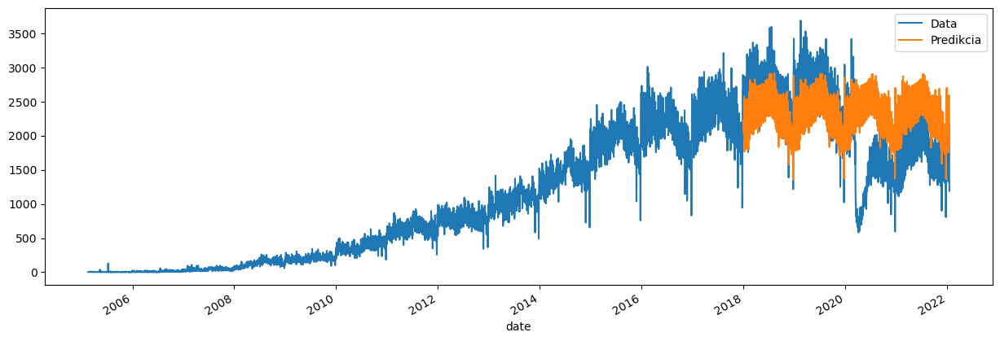

In [5]:
columns_drop = ['user_id','business_id','stars','useful','funny','cool','text'] 
df_review11.drop(columns_drop, inplace=True, axis=1)

df_review11.date = df_review11.date.str.split(' ').str.get(0)

df_review11 = df_review11.groupby(["date"])["review_id"].count().reset_index(name="pocet")

df_review11 = df_review11.set_index("date")

df_review11.index = pd.to_datetime(df_review11.index)

def create_features(df_review11):
    
    df_review11['hour'] = df_review11.index.hour
    df_review11['dayofweek'] = df_review11.index.dayofweek
    df_review11['quarter'] = df_review11.index.quarter
    df_review11['month'] = df_review11.index.month
    df_review11['year'] = df_review11.index.year
    df_review11['dayofyear'] = df_review11.index.dayofyear
    return df_review11

df_review11 = create_features(df_review11) 

train = df_review11.loc[df_review11.index  < '01-01-2018']
test = df_review11.loc[df_review11.index  >= '01-01-2018'] 


features = ['hour', 'dayofweek', 'quarter', 'month', 'year', 'dayofyear']
targerts = 'pocet'

X_train = train[features]
y_train = train[targerts]

X_test = test[features]
y_test = test[targerts]

reg = xgb.XGBRegressor(n_estimators = 1000,early_stopping_rounds = 50,learning_rate = 0.01)
reg.fit(X_train,y_train,eval_set=[(X_train, y_train), (X_test,y_test)],verbose = 0)
pd.set_option('mode.chained_assignment', None)

test['prediction'] = reg.predict(X_test)

df_review11 = df_review11.merge(test[['prediction']], how = 'left', left_index = True, right_index = True)

ax = df_review11[['pocet']].plot(figsize = (15,5))
df_review11['prediction'].plot(ax = ax)
plt.legend(['Data','Predikcia'])
plt.show()

In [4]:
#Geo mapa 

# je potrebne spustit rucne. Geo mapa ukazuje pocty hodnoteni na zaklade log. a lat.
np.warnings.filterwarnings('ignore')

data_file_business = open(r"C:\cesta\yelp_academic_dataset_business.json",encoding="utf8")
data_business1 = []

for line in data_file_business:
    data_business1.append(json.loads(line))
df_business = pd.DataFrame(data_business1)

df_business1 = df_business[df_business['is_open'] == 1] 

columns_drop = ['hours','attributes','postal_code','name','address','stars','state','categories','business_id','city','is_open']
df_business1.drop(columns_drop, inplace=True, axis=1) 

fig = px.density_mapbox(df_business
                        ,lat='latitude'
                        ,lon='longitude'
                        ,z='review_count'
                        ,mapbox_style="carto-darkmatter"
                        ,color_continuous_scale="ice"
                        ,zoom=2.95
                       )
 
fig.add_scattermapbox(lat = df_business['latitude']
                      ,lon = df_business['longitude']
                      ,hoverinfo = 'skip'        
                      ,below= ''            
                      ,marker_size= 2
                      ,marker_color= 'rgb(128, 128, 128)')

fig.update_layout(font=dict(family="Courier New",size=15,color="RebeccaPurple"))

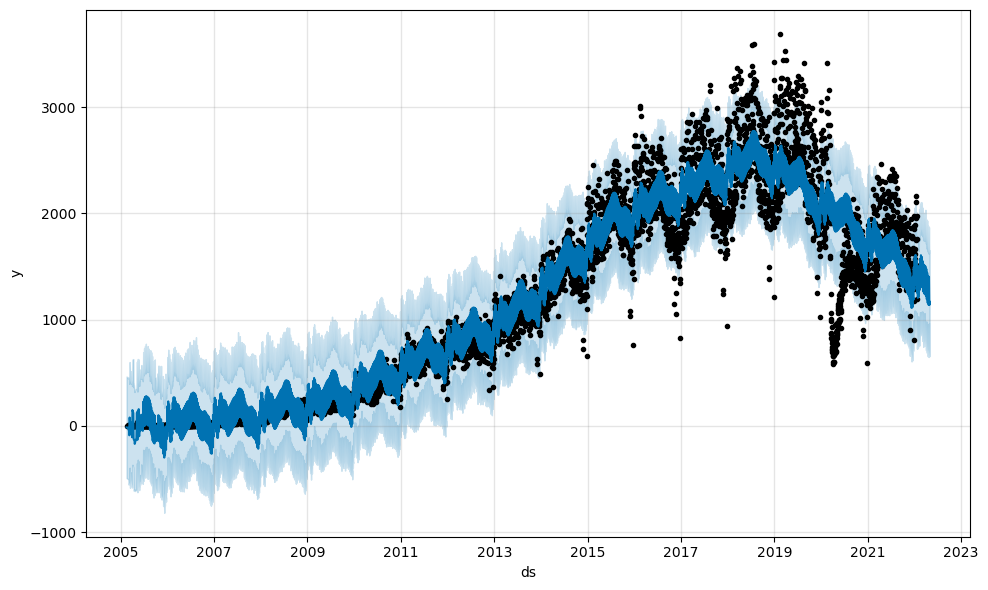

In [8]:
# Druhy predikcny model pouzivajuci kniznicu Prophet vyvijanu Facebook-om 

data_file_review = open(r"C:\cesta\yelp_academic_dataset_review.json",encoding="utf8")
data_review1 = []

for line in data_file_review:
    data_review1.append(json.loads(line))
df_review = pd.DataFrame(data_review1)

df_review11 = df_review.copy()

df_review11['date_real'] = pd.to_datetime(df_review11['date']).dt.strftime('%Y-%m-%d')

columns = ['user_id', 'business_id', 'business_id', 'useful', 'funny', 'cool', 'text','date']
df_review11.drop(columns, inplace=True, axis=1)

df_review11 = df_review11.groupby(["date_real"])["review_id"].count().reset_index(name="pocet")

df_review11.columns = ['ds','y']
df_review11 = df_review11[['y', 'ds']]

m = Prophet(interval_width=0.95, daily_seasonality=True)
model = m.fit(df_review11)

future = m.make_future_dataframe(periods=100,freq='D')
forecast = m.predict(future)

plot1 = m.plot(forecast)